The fintech company develops and maintains its own trading platform. The management has instructed you to analyze the trading activity of our users.  
The logic of the answer and the analyzed data can be determined independently, but I would like to get answers to the following questions:

* What trading behavior is typical for users by region and platform? What are the similarities and differences?
* Based on common behavioral patterns, which segments can users be divided into?
* Analyze the data, write conclusions and answer the question to Top management “How have the last 3 months of the company's activity gone, and in particular what are the results for June?".

### **Imports and customization**

In [1]:
import pandas as pd
import numpy as np


from dataclasses import dataclass, field

import matplotlib.pyplot as plt
import seaborn as sns
from seaborn import color_palette
import plotly.express as px
from plotly.graph_objects import Mesh3d, Figure, Frame, Pie, Font
from plotly.subplots import make_subplots
from plotly.figure_factory import create_distplot


from numpy.typing import ArrayLike, NDArray
from typing import Sequence, Literal
from dataclasses import dataclass, field

from datetime import datetime

from warnings import simplefilter

In [2]:
simplefilter('ignore', Warning)

pd.set_option('display.float_format', '{:.4f}'.format)
pd.options.display.max_rows = 50

plt.style.use('ggplot')

### **Uploading and describing data**

In [3]:
df = pd.read_csv('data/trading_data.csv')

One row in the data set represents a description of one deal. A deal is a one-time act of buying/selling a certain asset by the user and subsequent liquidation of the position, and if the position was closed in parts, then there will be as many deals as the number of closing acts initiated before the position is fully liquidated. Information about deals is contained in the following variables:
* `user_id` - user identifier;
* `user_registration_time` - date and time of registration on the platform;
* `deal_create_time` - date and time of deal opening;
* `deal_close_time` - date and time of deal closing;
* `instrument_type` - type of asset (trading instrument);
* `asset` - asset or trading pair name;
* `deal_platform` - the type of platform on which the deal was executed;
* `region` - user region;
* `pnl` - result of the deal (profit/loss) in quantitative terms.

In [4]:
df.head()

,user_id,user_registration_time,deal_create_time,deal_close_time,instrument_type,asset,deal_platform,region,pnl
0,511818141,2020-05-04 01:29:02.035977,2020-05-21 08:24:27.21+03,2020-05-21 08:25:03.66+03,digital-option,AUDJPY,Android,America (LATAM),-1.6666
1,144808927,2017-06-06 03:45:53.000000,2020-05-21 08:20:07.272+03,2020-05-21 08:25:06.323+03,digital-option,EURUSD,Web,ACO,-9.5999
2,518331028,2020-05-11 21:19:02.779547,2020-05-22 06:01:04.244+03,2020-05-22 06:02:02.791+03,digital-option,GBPUSD,Web,America (LATAM),-5.8636
3,483739956,2020-04-04 07:39:54.644213,2020-05-21 08:20:21.18+03,2020-05-21 08:25:04.869+03,digital-option,USDCHF,Android,ACO,-1.6666
4,483739956,2020-04-04 07:39:54.644213,2020-05-21 08:21:18.218+03,2020-05-21 08:25:06.067+03,digital-option,AUDCAD,Android,ACO,-1.6667


### **Data preprocessing**

In [5]:
df.isna().any()

user_id                   False
user_registration_time    False
deal_create_time          False
deal_close_time           False
instrument_type           False
asset                     False
deal_platform             False
region                    False
pnl                       False
dtype: bool

Checking the dataset for duplicates

In [6]:
df.groupby(df.columns.tolist(), as_index=False).size().shape

(200000, 10)

Check if all deals are in the same time zone (Moscow time zone)

In [7]:
(df.deal_close_time.str.slice(-3) == '+03').all(), (df.deal_create_time.str.slice(-3) == '+03').all()

(True, True)

Convert all dates to a convenient format

In [8]:
fmt = '%Y-%m-%d %H:%M:%S'

df['deal_create_time'] = pd.to_datetime(df.deal_create_time.str.slice(0, 19), format=fmt)
df['deal_close_time'] = pd.to_datetime(df.deal_close_time.str.slice(0, 19), format=fmt)
df['user_registration_time'] = pd.to_datetime(df.user_registration_time)

Add columns:
* the duration of each transaction in seconds;
* number of days since the moment of registration.

In [9]:
last_deal = df.deal_close_time.max()
last_deal

Timestamp('2020-06-11 04:55:05')

In [10]:
df['duration'] = (df.deal_close_time - df.deal_create_time).dt.total_seconds()
df['days_in'] = (df.user_registration_time - last_deal).abs().dt.days + 1

Getting rid of deals in a partial day (June 11)

In [11]:
df = df[df.deal_close_time.dt.date < last_deal.date()]

Optimize the dataframe for memory with type conversion and getting rid of unnecessary columns

In [12]:
df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
Index: 199998 entries, 0 to 199999
Data columns (total 11 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   user_id                 199998 non-null  int64         
 1   user_registration_time  199998 non-null  datetime64[ns]
 2   deal_create_time        199998 non-null  datetime64[ns]
 3   deal_close_time         199998 non-null  datetime64[ns]
 4   instrument_type         199998 non-null  object        
 5   asset                   199998 non-null  object        
 6   deal_platform           199998 non-null  object        
 7   region                  199998 non-null  object        
 8   pnl                     199998 non-null  float64       
 9   duration                199998 non-null  float64       
 10  days_in                 199998 non-null  int64         
dtypes: datetime64[ns](3), float64(2), int64(2), object(4)
memory usage: 62.4 MB


In [13]:
df.describe(include='all')

,user_id,user_registration_time,deal_create_time,deal_close_time,instrument_type,asset,deal_platform,region,pnl,duration,days_in
count,199998.0000,199998,199998,199998,199998,199998,199998,199998,199998.0000,199998.0000,199998.0000
unique,NaN,NaN,NaN,NaN,5,168,4,6,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,digital-option,EURUSD,Web,America (LATAM),NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,180374,31232,105906,125530,NaN,NaN,NaN
mean,402447185.8165,2019-07-31 03:54:11.307710720,2020-05-21 11:12:44.954024448,2020-05-21 14:58:58.709231872,NaN,NaN,NaN,NaN,-0.8294,13573.7552,316.5726
min,2070.0000,2013-10-31 01:36:12,2017-08-24 12:31:56,2020-05-09 06:03:56,NaN,NaN,NaN,NaN,-31322.3727,1.0000,1.0000
25%,354889977.0000,2019-05-17 19:50:03.500000,2020-05-15 10:41:17,2020-05-15 10:50:59.500000,NaN,NaN,NaN,NaN,-1.6666,43.0000,53.0000
50%,441388829.0000,2020-01-30 21:39:30.032081920,2020-05-21 08:29:45,2020-05-21 08:32:03,NaN,NaN,NaN,NaN,0.0505,62.0000,133.0000
75%,498592809.5000,2020-04-19 17:22:54.014338560,2020-05-26 10:15:13,2020-05-26 10:20:03,NaN,NaN,NaN,NaN,1.4341,217.0000,391.0000
max,540961824.0000,2020-06-10 05:03:55.531537,2020-06-10 10:51:18,2020-06-10 10:53:52,NaN,NaN,NaN,NaN,8451.2998,86822411.0000,2416.0000


In [14]:
df['days_in'] = df['days_in'].astype('int16')
df['duration'] = df['duration'].astype('int32')
df['user_id'] = df['user_id'].astype('int32')
df['pnl'] = df['pnl'].astype('float32')

In [15]:
df.drop(['user_registration_time', 'deal_close_time'], axis=1, inplace=True)

In [16]:
print(f'{df.memory_usage(deep=True).sum() / 1024**2:.1f} MB')

56.0 MB


As a result, we saved 6.4 MB of memory

In [17]:
df.asset.nunique()

168

In [18]:
df.instrument_type.unique()

array(['digital-option', 'cfd', 'forex', 'crypto', 'fx-option'],
      dtype=object)

In [19]:
df.region.unique()

array(['America (LATAM)', 'ACO', 'Reg Europe', 'Africa', 'China',
       'Non-reg Europe'], dtype=object)

### **User segments by behavioral patterns**

#### **Studying the intensity of deals**

##### Preparing the function to clean the emissions and data

In [20]:
@dataclass(slots=True)
class Result:
    sample: NDArray
    outliers: NDArray
    condition: NDArray
    summary: pd.DataFrame = field(repr=False)


def drop_outliers(sample: ArrayLike, method: Literal['iqr', 'mc', '3std']) -> Result:
    '''
    This function provides a few methods of cleaning outliers.
    - `iqr` uses interquantile range
    - `mc` uses medcouple, but work very slow with data including more then 10.000 samples
    - `3std` uses 3 standart deviations
    '''
    
    arr = np.array(sample)

    if method == '3std':
        mean, std = arr.mean(), arr.std()

        condition = abs((arr - mean) / std) <= 3
    elif method == 'iqr':
        q1, q3 = np.quantile(arr, .25), np.quantile(arr, .75)
        iqr = q3 - q1

        left_border = q1 - 1.5 * iqr
        right_border = q3 + 1.5 * iqr

        condition = (left_border <= arr) & (arr <= right_border)
    elif method == 'mc':
        q1, q3 = np.quantile(arr, .25), np.quantile(arr, .75)
        iqr = q3 - q1

        # need to develop my own implementation of O(nlogn) time complexity
        mc = medcouple(arr)

        if mc >= 0:
            left_degree_coef, right_degree_coef = -4, 3
        else:
            left_degree_coef, right_degree_coef = -3, 4

        left_border = q1 - 1.5 * np.exp(left_degree_coef * mc) * iqr
        right_border = q3 + 1.5 * np.exp(right_degree_coef * mc) * iqr

        condition = (left_border <= arr) & (arr <= right_border)
    else:
        raise ValueError('Unknown method')
        
    sample = arr[condition]
    outliers = arr[~condition]

    sample_input_size = arr.size
    sample_output_size = sample.size
    outliers_size = outliers.size
    outliers_share = f'{outliers_size / sample_input_size:.2%}'
 
    columns = (
        ('sample', 'input_size'), ('sample', 'output_size'),
        ('outliers', 'size'), ('outliers', 'share')
    )
    values = (sample_input_size, sample_output_size, outliers_size, outliers_share)

    summary = pd.DataFrame(data=[values], columns=columns, index=(method, ))

    result = Result(sample, outliers, condition, summary)
    
    return result

In [21]:
users = df.user_id.value_counts().reset_index()

In [22]:
users = (
    users
    .merge(df[['user_id', 'region', 'days_in']], on='user_id')
    .drop_duplicates(ignore_index=True)
)

In [23]:
users['deals_per_day'] = users['count'] / users['days_in']

In [24]:
users['count'] = users['count'].astype('int16')
users['days_in'] = users['days_in'].astype('int16')

In [25]:
users.head()

,user_id,count,region,days_in,deals_per_day
0,401067514,3641,America (LATAM),239,15.2343
1,102851208,728,ACO,1318,0.5524
2,324514559,499,ACO,535,0.9327
3,286337472,366,America (LATAM),723,0.5062
4,243709257,249,ACO,844,0.2950


##### Key part

Plotting raw data

In [26]:
regions = users.region.unique()

In [27]:
groups = [users[users.region == reg].deals_per_day for reg in regions]

In [28]:
boxplot_before = px.box(
    users.sort_values(by='region'), x='region', y='deals_per_day',
    color='region', height=500, notched=True, log_y=True,
    title='<b>Boxplot of logarithized initial values</b>'
)
density_before = create_distplot(groups, regions, show_hist=False, show_rug=False)

_ = boxplot_before.update_layout(dict(title_x=0.5))

_ = density_before.update_layout(dict(
    title=('<b>Distribution of the number of user deals per day'
           'from the moment of their registration by regions</b>'),
    title_x=0.5, height=800,
    yaxis=dict(title='<b>Density</b>'), xaxis=dict(title='<b>Deals per day</b>')
))

for i, trace_name in enumerate(regions):
    _ = density_before.data[i].update(dict(
        name=f'<b>{trace_name}</b>',
        hovertemplate=f'Deals per day: %{{x:.4f}}',
        line=dict(width=4)
    ))

Cleaning data from outliers

In [29]:
users = users.pivot_table(values='deals_per_day', index='user_id', columns='region').reset_index()

In [30]:
users.index = users.user_id
users.drop('user_id', axis=1, inplace=True)

In [31]:
results = {}

for region in regions:
    curr_ser = users.loc[:, region]
    indexes = curr_ser[~curr_ser.isna()].index

    res = drop_outliers(curr_ser[indexes], '3std')
    results[region] = res.summary

    curr_ser[indexes] = np.where(res.condition, curr_ser[indexes], np.nan)

In [32]:
users = users[~users.isna().all(axis=1)]

In [33]:
users = (
    users
    .reset_index()
    .melt(id_vars='user_id', value_vars=users.columns, value_name='deals_per_day')
    .dropna()
)

Plotting the cleaned data

In [34]:
groups = [users[users.region == reg].deals_per_day for reg in regions]

In [35]:
boxplot_after = px.box(
    users.sort_values(by='region'), x='region', y='deals_per_day',
    color='region', height=500, notched=True, log_y=True,
    title='<b>Boxplot of emission-cleaned logarithized values</b>'
)
density_after = create_distplot(groups, regions, show_hist=False, show_rug=False)

_ = boxplot_after.update_layout(dict(title_x=0.5))

_ = density_after.update_layout(dict(
    title=('<b>Distribution of the number of user deals per day'
           'from the moment of their registration by regions</b>'),
    title_x=0.5, height=800,
    yaxis=dict(title='<b>Density</b>'), xaxis=dict(title='<b>Deals per day</b>')
))

for i, trace_name in enumerate(regions):
    _ = density_after.data[i].update(dict(
        name=f'<b>{trace_name}</b>',
        hovertemplate=f'Deals per day: %{{x:.4f}}',
        line=dict(width=4)
    ))

Explore the results of data cleaning

In [36]:
results['America (LATAM)']

sample             outliers       
     input_size output_size     size  share
3std      60514       60127      387  0.64%

In [37]:
results['ACO']

sample             outliers       
     input_size output_size     size  share
3std      16229       16070      159  0.98%

In [38]:
results['China']

sample             outliers       
     input_size output_size     size  share
3std        200         197        3  1.50%

In [39]:
results['Africa']

sample             outliers       
     input_size output_size     size  share
3std       4786        4716       70  1.46%

In [40]:
results['Reg Europe']

sample             outliers       
     input_size output_size     size  share
3std       1490        1476       14  0.94%

In [41]:
results['Non-reg Europe']

sample             outliers       
     input_size output_size     size  share
3std        302         300        2  0.66%

As we can see, the share of outliers in each group doesn't exceed 1.5%

In [42]:
boxplot_before

In [43]:
boxplot_after

The logarithmic boxplot plot clearly shows the improvement. It still identifies quite a large number of outliers, but this is because we are dealing with a skewed distribution.

From the graph, we can conclude that the median transaction frequency is **highest in the America (LATAM)** and **lowest in Reg Europe**.

In [44]:
density_before

In [45]:
density_after

You can also see the improvement in the distribution density plot, but in a more obvious way.

It should be noted that the conclusion about Reg Europe is confirmed, and the maximum frequency of deals reaches the value of 0.1292, which corresponds to 1 deal once in 8 days.


In principle, all charts are similar to each other except for Reg Europe, which has the highest peak and decreases much faster than the others

#### **Duration of deals**

In [46]:
df = df[df.user_id.isin(users.user_id)]

In [47]:
do = df[df.instrument_type == 'digital-option']
cfd = df[df.instrument_type == 'cfd']
frx = df[df.instrument_type == 'forex']
fxo = df[df.instrument_type == 'fx-option']
crpt = df[df.instrument_type == 'crypto']

##### Digital-option deals

In [48]:
px.histogram(
    do.duration, nbins=int(do.duration.max()), histnorm='probability',
    title='<b>Duration of digital-option deals</b>'
)

##### FX-option deals

In [49]:
px.histogram(
    fxo.duration, nbins=100, histnorm='probability',
    title='<b>Duration of fx-option deals</b>'
)

##### Forex deals

In [50]:
px.histogram(
    frx.duration, histnorm='probability', title='<b>Duration of forex deals</b>'
)

In [51]:
px.histogram(
    frx.duration[frx.duration < 86_400],
    nbins=frx.duration[frx.duration < 86_400].nunique(),
    histnorm='probability', title='<b>Duration of forex deals (intraday)</b>'
)

##### Crypto deals

In [52]:
px.histogram(
    crpt.duration, histnorm='probability', title='<b>Duration of crypto deals</b>'
)

In [53]:
px.histogram(
    crpt.duration[crpt.duration < 86_400], nbins=100, histnorm='probability',
    title='<b>Duration of crypto deals (intraday)</b>'
)

##### CFD deals

In [54]:
px.histogram(
    cfd.duration, histnorm='probability', title='<b>Duration of cfd deals</b>'
)

In [55]:
px.histogram(
    cfd.duration[cfd.duration < 86_400], nbins=100, histnorm='probability',
    title='<b>Duration of cfd deals (intraday)</b>'
)

##### Conclusion

In principle, the distributions of deal durations for cfd, forex and crypto are very similar in all these types of instruments speculative trades prevail. Nevertheless, each of these distributions has long tails, which indicate that among the total mass of deals there are also medium-term ones. Crypto distribution slightly differs from the other two distributions by the longest tail, which implies the presence of long-term deals.

A completely different picture is formed on digital-option and fx-option instruments. These instruments are purely speculative in nature, as the execution time of these options is fixed. It should be noted that the most popular among digital-options are options for 30 seconds, 1 minute, 5 minutes and 15 minutes, and among fx-options - for 1 minute and 1 hour.

As a result, several user segments can be distinguished:
* long-term investors (crypto only);
* medium-term investors (crypto, cfd and forex only);
* short-term investors.

Among short-term investors it would be reasonable to distinguish:
* scalpers (deal duration is less than 1 minute);
* day traders.

### **Trading behavior by region and platform**

#### **Preferred assets**

In [56]:
groups = df.groupby(['instrument_type', 'asset']).size()
instrument_types = sorted(df[df['instrument_type'] != 'fx-option'].instrument_type.unique())
rows, cols = 2, 2
specs = [[{"type": "domain"} for _ in range(cols)] for _ in range(rows)]

In [57]:
def pie(instrument_type: str, cmap: str = 'magma', others_size: float = 0.05):
    g: pd.Series = groups[instrument_type].sort_values()

    main_assets = g[g.cumsum() >= g.sum() * others_size]
    other_assets = g[g.cumsum() < g.sum() * others_size]

    # Since the original Series is sorted from smallest to largest, this is also
    # true for its subsamples. Then the first value and index should be the 
    # others group. Unfold it so that the piechart is built from the largest to
    # the smallest, not vice versa
    inds = (['others'] + list(main_assets.index))[::-1]
    vals = ([other_assets.sum()] + list(main_assets.values))[::-1]

    colors = [
        f'rgb({", ".join(str(int(val * 255)) for val in color)})'
        for color in sns.color_palette(cmap, n_colors=len(vals))
    ]

    fig = Pie(
        labels=inds, values=vals, name=instrument_type, sort=False,
        direction='clockwise', marker={'colors': colors}
    )

    fig = Figure(fig)
    fig.update_layout(width=900, height=900)
    
    return fig

In [58]:
pie('digital-option', cmap='magma', others_size=0.05)

In [59]:
pie('forex')

In [60]:
pie('cfd')

Нефть, золото, серебро, акции

In [61]:
pie('crypto')

In [62]:
pie('fx-option')

#### **User preferences by region and platform**

In [63]:
groups = df.groupby(['region', 'instrument_type']).size()
regions = sorted(df.region.unique())
rows, cols = 2, 3
specs = [[{"type": "domain"} for _ in range(cols)] for _ in range(rows)]

In [64]:
fig = make_subplots(
    rows=rows, cols=cols, specs=specs, subplot_titles=[f'<b>{reg}</b>' for reg in regions],
    horizontal_spacing=0, vertical_spacing=0.15
)

for ind, region in enumerate(regions):
    fig.add_trace(
        Pie(
            labels=groups[region].index, values=groups[region].values,
            name=region, textfont=Font(size=12), hoverinfo='value+name+label',
            direction='clockwise'
        ),
        ind // cols + 1, ind % cols + 1
    )

    y = 0.475 if ind // cols else 1.05
    
    fig.layout.annotations[ind].update(y=y)

fig.update_layout(width=1500, height=800)
fig.update_annotations(font_size=20)

* crypto is not popular in almost any region.
* cfd is also not popular except in European regions
* digital-option is the predominant instrument in all regions, except Reg Europe, where it is only on the 4th place in terms of popularity.
* fx-option deals are available only in Reg Europe region,
* there are no crypto deals in China

In [65]:
groups = df.groupby(['deal_platform', 'instrument_type']).size()
deal_platform = sorted(df.deal_platform.unique())
rows, cols = 2, 2
specs = [[{"type": "domain"} for _ in range(cols)] for _ in range(rows)]

In [66]:
fig = make_subplots(
    rows=rows, cols=cols, specs=specs, subplot_titles=[f'<b>{plat}</b>' for plat in deal_platform],
    horizontal_spacing=0, vertical_spacing=0.15
)

for ind, plat in enumerate(deal_platform):
    fig.add_trace(
        Pie(
            labels=groups[plat].index, values=groups[plat].values,
            name=plat, textfont=Font(size=12), hoverinfo='value+name+label',
            direction='clockwise'
        ),
        ind // cols + 1, ind % cols + 1
    )

    y = 0.475 if ind // cols else 1.055
    
    fig.layout.annotations[ind].update(y=y)

fig.update_layout(width=1500, height=900)
fig.update_annotations(font_size=20)

There are almost no differences in user behavior depending on the platform, except that the share of forex on the Web platform is slightly higher than on the others. It is noteworthy that almost no deals were made on the Web_mobile platform during the whole time, their total number is 81 deals and only on the digital-option instrument.

#### **Distribution of the duration of the deal by region and platform**

The digital-option tool had the largest number of deals and they were made in all regions, but there are omissions for the other types of tools, so let's compare the trading behavior of users for digital-option.

In [67]:
px.histogram(
    do, x='duration', facet_col='deal_platform', facet_col_wrap=2,
    histnorm='probability', height=800
)

It is impossible to draw specific conclusions about the Web_mobile platform, as too few deals have been made on it relative to the others. However, it can be noted that on the Web platform 1 minute and 5 minute options are more popular than on mobile applications

In [68]:
px.histogram(
    do, x='duration', facet_col='region', facet_col_wrap=2,
    histnorm='probability', height=800
)

Regarding these distributions, it can be noted that in the America (LATAM) region, 1-minute, 5-minute and 15-minute options are more popular than in other regions. Otherwise, the distributions are very similar to each other, i.e. there are no significant differences

### **Evaluating the platform's performance**

#### **Preparing functions**

In [69]:
# Error messages
msg_ticks = 'The {} parameter must conform to the sequence protocol and contain string values'
msg_indent = 'The value of the indent parameter must be in the interval [0; 1)'
msg_bool = 'The argument passed to the {} parameter must be a boolean value'
msg_speed = 'The argument passed in the speed parameter must be an integer or float value'
msg_neg_speed = 'Speed multiplier сannot be a negative or zero value'
msg_neg_val = 'Negative value detected in the passed data array'
msg_shape = ("The passed array isn't reshapable according to the passed "
             "parameters xticks, yticks and animation_ticks.")
msg_cols = ('The passed argument for the data parameter contains {} columns, '
            'but {} ticks were passed for the x-axis.')
msg_rows = ('The passed argument for the data parameter contains {} rows, '
            'but {} ticks were passed for the y-axis.')
msg_depth = ('The passed argument for the data parameter contains {} depth '
             'levels, but {} ticks were passed for the animation axis.')
msg_two_to_three = ('A two-dimensional array cannot be converted to a '
                    'three-dimensional array. Remove the animation_ticks '
                    'parameter or change the shape of the array.')


def barchart3d(
        data: ArrayLike, *, xticks: Sequence[str] = None, yticks: Sequence[str] = None,
        xlabel: str = None, ylabel: str = None, zlabel: str = None,
        title: str = None, animation_ticks: Sequence[str] = None,
        animation_title: str = None, cmap: str = 'magma_r', width: int = None,
        height: int = None, indent: float = 0.1, log_scale: bool = False,
        sort: bool = False, speed: int | float = 1
) -> Figure:
    '''
    Builds 3D bar chart with animation capability.

    Parameters
    ----------
        data: numpy.typing.ArrayLike
            One-/two-/three-dimensional array of non-negative values. If a
            one-dimensional array is passed, its shape must be reshapable to
            two-dimensional (if only xticks and yticks are passed) or
            three-dimensional (if animation_ticks are passed) using
            numpy.reshape().
        xticks: Sequence[str], default None
            Ticks for x scale i.e. columns in data
        yticks: Sequence[str], default None
            Ticks for y scale i.e. rows in data
        xlabel: str, default None
            The name of x scale i.e. columns in data
        ylabel: str, default None
            The name of y scale i.e. rows in data
        zlabel: str, default None
            The name of what the values in the data mean
        title: str, default None
            The title of barplot
        animation_ticks: Sequence[str], default None
            Ticks for animation scale i.e. depth of data (if not None)
        animation_title: str, default None
            The titile for animation scale
        cmap: str, default 'magma_r'
            The name of colormap for barplot. Possible palette values include:
                1. name of matplotlib colormap
                2. 'husl' or 'hls'
                3. 'ch:<cubehelix arguments>'
                4. 'light:<color>', 'dark:<color>', 'blend:<color>,<color>',
                5. a sequence of colors in any format matplotlib accepts
        width: int, default None
            Width of the graph (in pixels)
        height: int, default None
            Height of the graph (in pixels)
        indent: float, dafault 0.1
            Bar spacing, that must be in the interval [0; 1)
        log_scale: bool, default False
            Whether it's necessary to logarithmize the values on the
            z-axis that were passed to the data parameter. When set to True,
            z-scale values are hidden because they aren't relevant
        sort: bool, default False
            Determines whether sorting is necessary. If set to True, sorting is
            performed on the x and y axes
        speed: int or float, default 1
            Animation speed multiplier. Cannot be a negative or zero value

    Returns
    -------
    return plotly.graph_objects.Figure()

    Notes
    -----
    Note that the final dimensionality of the data to be reflected in the
    barplot is determined by the xticks, yticks and animation_ticks (if given)
    parameters.

    There are several scenarios of the function operation depending on the
    dimensionality of the passed array:
    1. if a one-dimensional array is input, it will be converted to a two- or
    three-dimensional array, depending on whether the animation_ticks parameter
    is passed and whether the number of values in the current array is
    comparable to the expected number.
    2. if a two-dimensional array is input, it won't be converted to
    a three-dimensional array. In this case, a check will be performed to see if
    the shape of the array matches the sizes of the passed xtick and ytick
    sequences. If you pass animation_ticks together with a two-dimensional
    array, an exception will be raised.
    3. if a three-dimensional array is input, only a check will be performed to
    see if the shape of the array matches the sizes of the passed xtick, ytick
    and animation_ticks sequences.

    If there is a need to move text in ticks, axis labels or title to a new
    line, it's necessary to pass a string containing HTML tag <br> in the
    appropriate place to the input of the corresponding parameter.
    '''

    # Validate passed arguments
    _validate_args(
        data=data, xticks=xticks, yticks=yticks, animation_ticks=animation_ticks,
        log_scale=log_scale, indent=indent, sort=sort, speed=speed
    )

    # Trying to get the correct NDarray based on the given arguments for ticks.
    data = _get_reshaped_data(
        data=data, xticks=xticks, yticks=yticks, animation_ticks=animation_ticks
    )

    depth, nrows, ncols = data.shape

    if sort:
        data, xticks, yticks = _get_sorted_data(
            data=data, xticks=xticks, yticks=yticks)

    # Determine the side size of one bar
    bar_side = 1 - indent

    figure_config = dict()

    # Format axis captions and chart name, if they are set
    xlabel = f'<b>{xlabel}</b>' if xlabel else ''
    ylabel = f'<b>{ylabel}</b>' if ylabel else ''
    zlabel = f'<b>{zlabel}</b>' if zlabel else ''
    title = f'<b>{title}</b>' if title else None
    animation_title = f'{animation_title}: ' if animation_title else None

    # Looking for the aspect ratio to make the bars square rather than rectangular
    x_aspect = 1
    y_aspect = nrows / ncols
    z_aspect = min(x_aspect, y_aspect)

    # Customizes the height, width, indents, lettering, and aspect ratio of the shape
    figure_config['layout'] = dict(
        width=width, height=height, margin=dict(l=40, r=40, b=60, t=0),
        title=dict(text=title, font=dict(size=20), x=0.5, y=0.95),
        scene=dict(
            aspectmode='manual',
            aspectratio=dict(x=x_aspect, y=y_aspect, z=z_aspect),
            xaxis=dict(title=xlabel, tickvals=list(range(ncols)), ticktext=xticks),
            yaxis=dict(title=ylabel, tickvals=list(range(nrows)), ticktext=yticks),
            zaxis=dict(title=zlabel, showticklabels=(not log_scale))
        )
    )

    # Create the basic (first) figure
    first_screen = _get_list_of_bars(
        mat=data[0], xticks=xticks, yticks=yticks, xlabel=xlabel, ylabel=ylabel,
        bar_side=bar_side, cmap=cmap, log_scale=log_scale, ncols=ncols, nrows=nrows
    )
    figure_config['data'] = first_screen

    # If a three-dimensional array, create frames and slider
    if depth > 1:
        frames = [
            Frame(
                data=_get_list_of_bars(
                    mat=data[level], xticks=xticks, yticks=yticks,
                    xlabel=xlabel, ylabel=ylabel, bar_side=bar_side, cmap=cmap,
                    log_scale=log_scale, ncols=ncols, nrows=nrows
                ),
                name=animation_ticks[level]
            )
            for level in range(depth)
        ]
        figure_config['frames'] = frames

        # Configure the display of the current value on the slider,
        # the location and animation of the slider slider
        sliders_dict = dict(
            active=0,
            currentvalue=dict(
                font=dict(size=16), prefix=animation_title,
                visible=True,
                xanchor="left"
            ),
            transition=dict(duration=500 / speed, easing='cubic-in-out'),
            len=0.9, x=0.1, pad=dict(b=10, t=15),
            steps=[]
        )

        # Filling the slider with steps
        steps = [
            dict(
                args=[[tick], dict(duration=300 / speed, mode='immediate')],
                label=tick, method="animate"
            )
            for tick in animation_ticks
        ]
        sliders_dict['steps'] = steps

        # Configure the display of the buttons location, their appearance and
        # animation method
        updatemenus_dict = dict(
            direction='left', pad=dict(r=20, t=40),
            xanchor="right", yanchor="top", x=0.1, y=0,
            type='buttons',
            buttons=[
                dict(
                    args=[
                        None,
                        dict(
                            frame=dict(duration=300 / speed),
                            fromcurrent=True,
                            transition=dict(
                                duration=300 / speed, easing='quadratic-in-out'
                            )
                        )
                    ],
                    label='►',
                    method="animate"
                ),
                dict(
                    args=[[None], dict(mode='immediate')],
                    label='❚❚',
                    method="animate"
                )
            ]
        )
        figure_config['layout'].update(dict(
            sliders=[sliders_dict],
            updatemenus=[updatemenus_dict]
        ))

    fig = Figure(figure_config)

    return fig


def _validate_args(
        *, data, xticks, yticks, animation_ticks, log_scale, indent, sort, speed
) -> None:
    '''
    Checks whether the values and types of the passed objects match the
    required ones.
    '''
    def is_seq(x): return hasattr(x, '__getitem__') and hasattr(x, '__len__')
    def contains_str(x): return all((isinstance(elem, str) for elem in x))

    if not (is_seq(xticks) and contains_str(xticks)):
        raise TypeError(msg_ticks.format('xticks'))
    if not (is_seq(yticks) and contains_str(yticks)):
        raise TypeError(msg_ticks.format('yticks'))

    if animation_ticks and not (is_seq(animation_ticks) and contains_str(animation_ticks)):
        raise TypeError(msg_ticks.format('animation_ticks'))

    if not isinstance(log_scale, bool):
        raise TypeError(msg_bool.format('log_scale'))
    if not isinstance(sort, bool):
        raise TypeError(msg_bool.format('sort'))
    if not isinstance(speed, int | float):
        raise TypeError(msg_speed)

    if not (0 <= indent < 1):
        raise ValueError(msg_indent)
    if np.min(data) < 0:
        raise ValueError(msg_neg_val)
    if speed <= 0:
        raise ValueError(msg_neg_speed)

    return


def _get_reshaped_data(*, data, xticks, yticks, animation_ticks) -> NDArray:
    '''
    Converts an ArrayLike object to an NDarray, checks that the dimensionality
    and size of the original array are correct relative to the expected ones,
    and reshapes the data if necessary.
    '''
    data = np.array(data)

    dims = data.shape

    # Getting the required data shape
    x_len = len(xticks)
    y_len = len(yticks)
    animation_len = len(animation_ticks) if animation_ticks else 1

    match len(dims):
        case 1:
            depth, nrows, ncols = 1, 1, dims

            if data.size != x_len * y_len * animation_len:
                raise ValueError(msg_shape)

            data = np.reshape(data, (animation_len, y_len, x_len))
        case 2:
            depth, nrows, ncols = 1, *dims

            if ncols != x_len:
                raise ValueError(msg_cols.format(ncols, x_len))
            if nrows != y_len:
                raise ValueError(msg_rows.format(nrows, y_len))
            if animation_ticks:
                raise ValueError(msg_two_to_three)

            data = np.reshape(data, (animation_len, *dims))
        case 3:
            depth, nrows, ncols = dims

            if ncols != x_len:
                raise ValueError(msg_cols.format(ncols, x_len))
            if nrows != y_len:
                raise ValueError(msg_rows.format(nrows, y_len))
            if depth != animation_len:
                raise ValueError(msg_depth.format(depth, animation_len))
        case _:
            raise ValueError(msg_shape)

    return data


def _get_sorted_data(
        *, data: NDArray, xticks: Sequence[str], yticks: Sequence[str]
) -> tuple[NDArray, Sequence[str], Sequence[str]]:
    mat_sum = data.sum(axis=0)

    # Find the sums by axes for further sorting
    row_sum = mat_sum.sum(axis=1)
    col_sum = mat_sum.sum(axis=0)

    # Find the order of rows and columns and take their indices
    row_order: list[int] = [
        np.where(row_sum == val)[0][0]
        for val in sorted(row_sum, reverse=True)
    ]
    col_order: list[int] = [
        np.where(col_sum == val)[0][0]
        for val in sorted(col_sum, reverse=True)
    ]

    # Changing the order of the labels
    row_labels = [yticks[ind] for ind in row_order]
    col_labels = [xticks[ind] for ind in col_order]

    # Create a tensor with correct arrangement of columns and rows
    data = data[:, row_order, :][:, :, col_order]

    return data, col_labels, row_labels


def _get_list_of_bars(
        mat: ArrayLike, xticks: Sequence[str], yticks: Sequence[str],
        xlabel: str, ylabel: str, bar_side: float, cmap: str, log_scale: bool,
        ncols: int, nrows: int
) -> list[Mesh3d]:
    traces: list[Mesh3d] = []

    mat_unique_vals = np.unique(mat)

    # Creating a color palette
    n_colors = mat_unique_vals.size
    colors = color_palette(palette=cmap, n_colors=n_colors)

    # The matrix is processed so that the maximum value is located in the far
    # corner of the figure
    for y in range(nrows):
        for x in range(ncols):
            val = mat[y, x]

            # Get the coordinates of the bar
            x_min, x_max = x - bar_side / 2, x + bar_side / 2
            y_min, y_max = y - bar_side / 2, y + bar_side / 2

            # Get the color for the current value from the color palette array
            color = colors[np.where(mat_unique_vals == val)[0][0]]
            rgb_str = f'rgb({", ".join(str(int(i * 255)) for i in color)})'

            # Customize the legend in the pop-up window that appears when
            # hovering over the bar
            if xlabel and ylabel:
                hovertext = (
                    f'{xlabel}: {xticks[x].replace("<br>", " ")}<br>'
                    f'{ylabel}: {yticks[y].replace("<br>", " ")}<br>'
                    f'<b>Value</b>: {val}'
                )
            else:
                hovertext = (
                    f'{xticks[x]}<br>'
                    f'{yticks[y]}<br>'
                    f'<b>Value</b>: {val}'
                )

            bar = Mesh3d(
                x=[x_min, x_min, x_max, x_max, x_min, x_min, x_max, x_max],
                y=[y_min, y_max, y_max, y_min, y_min, y_max, y_max, y_min],
                z=[0] * 4 + [np.log(val + 1) if log_scale else val] * 4,
                alphahull=0,
                color=rgb_str, flatshading=True,
                hovertext=hovertext, hoverinfo='text'
            )
            traces.append(bar)

    return traces

In [70]:
def fill(df, one, two, three):
    all_indexes = {(i, j, k) for i in one for j in two for k in three}
    missing_indexes = all_indexes - set(df.index)

    return pd.concat([pd.Series(data=0, index=missing_indexes), df]).sort_index()

#### **Preparing the data**

In [71]:
deals = df[['instrument_type', 'region', 'deal_platform', 'user_id']].copy()
deals['date'] = df.deal_create_time.dt.date

In [72]:
dates = sorted(deals.date.unique())
regions = sorted(deals.region.unique())
instrument_types = sorted(deals.instrument_type.unique())
deal_platforms = sorted(deals.deal_platform.unique())

In [73]:
dates_formated = [d.strftime('%d %B %Y') for d in dates]
regions_formated = [label.replace(' ', '<br>') for label in regions]

#### **Number of deals by regions and types of instruments**

In [74]:
reg_instr = deals.groupby(['date', 'region', 'instrument_type']).size()

Filling in the blanks

In [75]:
reg_instr = fill(reg_instr, dates, regions, instrument_types)

Generating tensors

In [76]:
reg_instr = np.reshape(reg_instr, (len(dates), len(regions), len(instrument_types)))
cum_reg_instr = np.cumsum(reg_instr, axis=0)

In [77]:
fig = barchart3d(
    reg_instr, xticks=instrument_types, yticks=regions_formated, ylabel='Region',
    xlabel='Instrument type', zlabel='Number of deals', log_scale=True, sort=True,
    title='Number of deals for the period<br>of platform operation',
    animation_ticks=dates_formated, animation_title='Date', width=750, height=500
)

camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.75, y=1.75, z=1.25)
)

fig.update_layout(scene_camera=camera)

In [78]:
fig = barchart3d(
    cum_reg_instr, xticks=instrument_types, yticks=regions_formated, ylabel='Region',
    xlabel='Instrument type', zlabel='Number of deals', sort=True,
    title='Cumulative number of deals<br>for the period of platform operation',
    animation_ticks=dates_formated, animation_title='Date', width=750, height=500
)

camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.75, y=1.75, z=1.25)
)

fig.update_layout(scene_camera=camera)

#### **Number of deals by region and platform**

In [79]:
reg_plat = deals.groupby(['date', 'region', 'deal_platform']).size()

In [80]:
reg_plat = fill(reg_plat, dates, regions, deal_platforms)

In [81]:
reg_plat = np.reshape(reg_plat, (len(dates), len(regions), len(deal_platforms)))
cum_reg_plat = np.cumsum(reg_plat, axis=0)

In [82]:
fig = barchart3d(
    cum_reg_plat, xticks=deal_platforms, yticks=regions_formated, ylabel='Region',
    xlabel='Deal platform', zlabel='Number of deals', sort=True,
    title='Cumulative number of deals for the period<br>of platform operation',
    animation_ticks=dates_formated, animation_title='Date', width=750, height=500
)

camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.75, y=1.75, z=1.25)
)

fig.update_layout(scene_camera=camera)

#### **Number of deals by platform and instrument type**

In [83]:
plat_instr = deals.groupby(['date', 'deal_platform', 'instrument_type']).size()

In [84]:
plat_instr = fill(plat_instr, dates, deal_platforms, instrument_types)

In [85]:
plat_instr = np.reshape(plat_instr, (len(dates), len(deal_platforms), len(instrument_types)))
cum_plat_instr = np.cumsum(plat_instr, axis=0)

In [86]:
fig = barchart3d(
    cum_plat_instr, xticks=instrument_types, yticks=deal_platforms, ylabel='Deal platform',
    xlabel='Instrument type', zlabel='Number of deals', sort=True,
    title='Cumulative number of deals for the period<br>of platform operation',
    animation_ticks=dates_formated, animation_title='Date', width=750, height=500
)

camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.75, y=1.75, z=1.25)
)

fig.update_layout(scene_camera=camera)

#### **DAU and MAU by region and platform**

In [87]:
regions_formated = [reg.replace(' ', '<br>') for reg in sorted(df.region.unique())]
deal_platforms = sorted(df.deal_platform.unique())

In [88]:
mau = df[['deal_platform', 'region', 'user_id']].copy()

In [89]:
bins = pd.date_range('2017-07-31', '2020-06-30', freq='M')

mau['month'] = pd.cut(df.deal_create_time, bins=bins, right=True, labels=bins[1:])

In [90]:
mau = mau.groupby(['month', 'region', 'deal_platform']).user_id.nunique()

In [91]:
dates_formated = bins[1:].strftime('%B %Y').to_list()

In [92]:
fig = barchart3d(
    mau.values, xticks=deal_platforms, yticks=regions_formated, xlabel='Platform',
    ylabel='Region', zlabel='MAU', animation_ticks=dates_formated,
    animation_title='Date', title='Monthly Active Users by region and platform',
    sort=True, width=750, height=500
)

camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.75, y=1.75, z=1.25)
)

fig.update_layout(scene_camera=camera)

In [93]:
dau = df[['deal_platform', 'region', 'user_id']].copy()
dau['date'] = df.deal_create_time.dt.date
dau = dau[df.deal_create_time >= datetime(2020, 4, 1)]

In [94]:
bins = pd.date_range('2020-04-01', '2020-06-11', freq='d')

dau['day'] = pd.cut(df.deal_create_time, bins=bins, right=True, labels=bins[:-1])

In [95]:
dau = dau.groupby(['day', 'region', 'deal_platform']).user_id.nunique()

In [96]:
dates_formated = bins[:-1].strftime('%d %B %Y').to_list()

In [97]:
fig = barchart3d(
    dau.values, xticks=deal_platforms, yticks=regions_formated, xlabel='Platform',
    ylabel='Region', zlabel='DAU', animation_ticks=dates_formated, sort=True,
    animation_title='Date', title='Dayly Active Users by region and platform',
    width=750, height=500
)

camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.75, y=1.75, z=1.25)
)

fig.update_layout(scene_camera=camera)

In [98]:
mean_dau = dau.sum() / len(pd.date_range('2020-04-01', '2020-06-10', freq='d'))
print(f"DAU for the last 3 months of the platform's operation: {mean_dau:.0f} unique users per day")

DAU for the last 3 months of the platform's operation: 1730 unique users per day


Finally, let's look at the general trend of deals

In [99]:
df

,user_id,deal_create_time,instrument_type,asset,deal_platform,region,pnl,duration,days_in
0,511818141,2020-05-21 08:24:27,digital-option,AUDJPY,Android,America (LATAM),-1.6666,36,39
1,144808927,2020-05-21 08:20:07,digital-option,EURUSD,Web,ACO,-9.5999,299,1102
2,518331028,2020-05-22 06:01:04,digital-option,GBPUSD,Web,America (LATAM),-5.8636,58,31
5,442722262,2020-05-26 10:13:00,digital-option,EURUSD,Web,America (LATAM),-0.6036,62,130
6,486039089,2020-06-02 08:49:20,cfd,XAUUSD,Web,America (LATAM),-0.1023,671,66
...,...,...,...,...,...,...,...,...,...
199995,341599312,2020-05-24 08:45:03,digital-option,USDJPY-OTC,Web,America (LATAM),-0.1685,296,448
199996,184441270,2020-05-22 06:05:20,digital-option,EURUSD,Web,America (LATAM),1.4027,42,970
199997,300965817,2020-05-13 08:19:40,digital-option,USDCHF,Web,America (LATAM),25.2637,82,645
199998,472410662,2020-05-13 08:20:01,digital-option,USDCHF,Web,America (LATAM),-1.1543,61,82


In [100]:
df.deal_create_time.dt.date.value_counts().sort_index().reset_index()

,deal_create_time,count
0,2017-08-24,1
1,2017-09-05,1
2,2017-11-09,1
3,2017-12-01,1
4,2017-12-13,2
...,...,...
83,2020-06-06,1068
84,2020-06-07,1570
85,2020-06-08,1458
86,2020-06-09,1252


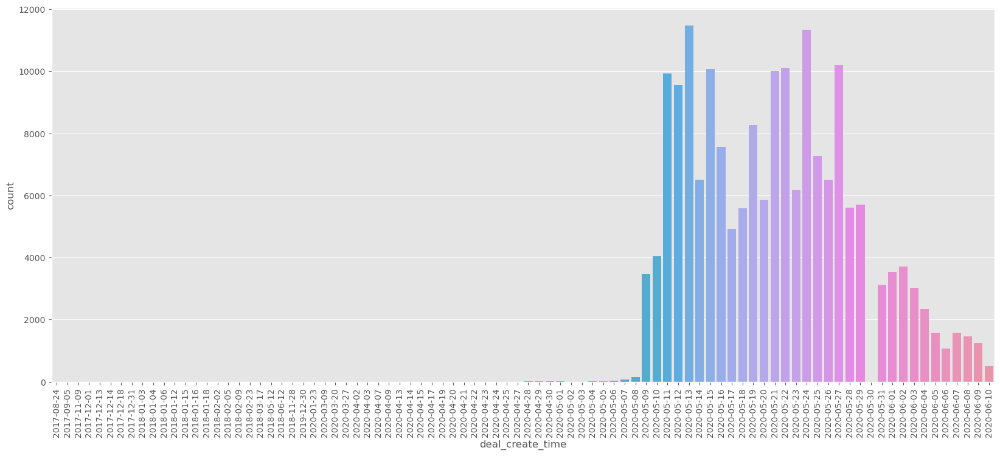

In [101]:
plt.figure(figsize=(20, 8))

sns.barplot(
    data=df.deal_create_time.dt.date.value_counts().sort_index().reset_index(),
    x='deal_create_time', y='count'
)
plt.xticks(rotation=90);

#### **Conclusion**

The first deal on the Web_mobile platform took place on May 9 and since then almost no one has traded on it, which allows us to conclude that the introduction of this trading platform is an extremely unsuccessful initiative.

There are visible problems with adapting the platform to IOS, as its Android counterpart is more popular

The first deal on digital-option took place on May 9 and since then this instrument has become very popular, which leads us to the conclusion that the emergence of digital-option is an extremely successful initiative that has become a growth driver for the platform

The first fx-option deal took place on May 11. Apparently, this tool is currently available only for the Rig Europe region, but this tool has gained significant popularity there.
It is also important to note that for unknown reasons, this instrument was not traded on May 16-18, May 23-25, May 30 - June 1, June 6-8 like cfd and forex instruments.

On June 30, nothing was traded on the platform

Over the past 3 months, 2 new regions have been added to the platform:
* Africa - April 9th;
* China - May 8th

The DAY for the last 3 months - 1730.